<a href="https://colab.research.google.com/github/logicalschema/Fall-2021/blob/main/DATA608/module2/notebook/Data_608_Module2.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Introduction

Author: **Sung Lee**  
Semester: Fall 2021

This Jupyer Notebook is for my Data 608 course.

In [ ]:
# The following lines were added to get the Jupyter Notebook working in Colab
!pip install datashader
!pip install pyproj

# Be sure to update IPython otherwise GeoJSON will not work
# Also be sure to restart the runtime environment once when this section of code runs
!pip install -U IPython 
from shapely.geometry import box

# Download of the data set from Github
!wget https://github.com/logicalschema/Fall-2021/raw/main/DATA608/module2/nyc_pluto_21v2_csv.zip
!unzip nyc_pluto_21v2_csv.zip




In [2]:
import datashader as ds
import datashader.transfer_functions as tf
import datashader.glyphs
from datashader import reductions
from datashader.core import bypixel
from datashader.utils import lnglat_to_meters as webm, export_image
from datashader.colors import colormap_select, Greys9, viridis, inferno
import copy


from pyproj import Proj, transform
import numpy as np
import pandas as pd
import urllib
import json
import datetime
import colorlover as cl

import plotly.offline as py

# Added by Sung Lee
import plotly.express as px

import plotly.graph_objs as go
from plotly import tools

# from shapely.geometry import Point, Polygon, shape
# In order to get shapley, you'll need to run [pip install shapely.geometry] from your terminal

from functools import partial

from IPython.display import GeoJSON

# This line was added by Sung Lee for HTML function
from IPython.display import HTML

py.init_notebook_mode()

For module 2 we'll be looking at techniques for dealing with big data. In particular binning strategies and the datashader library (which possibly proves we'll never need to bin large data for visualization ever again.)

To demonstrate these concepts we'll be looking at the PLUTO dataset put out by New York City's department of city planning. PLUTO contains data about every tax lot in New York City.

PLUTO data can be downloaded from [here](https://www1.nyc.gov/site/planning/data-maps/open-data/dwn-pluto-mappluto.page). Unzip them to the same directory as this notebook, and you should be able to read them in using this (or very similar) code. Also take note of the data dictionary, it'll come in handy for this assignment.

In [3]:
# Code to read in v17, column names have been updated (without upper case letters) for v18

# bk = pd.read_csv('PLUTO17v1.1/BK2017V11.csv')
# bx = pd.read_csv('PLUTO17v1.1/BX2017V11.csv')
# mn = pd.read_csv('PLUTO17v1.1/MN2017V11.csv')
# qn = pd.read_csv('PLUTO17v1.1/QN2017V11.csv')
# si = pd.read_csv('PLUTO17v1.1/SI2017V11.csv')

# ny = pd.concat([bk, bx, mn, qn, si], ignore_index=True)

# ny = pd.read_csv('nyc_pluto_21v2_csv/pluto_21v2.csv')
# This line was edited to use the data file via Github download
ny = pd.read_csv('pluto_21v2.csv')

# Getting rid of some outliers
ny = ny[(ny['yearbuilt'] > 1850) & (ny['yearbuilt'] < 2020) & (ny['numfloors'] != 0)]

/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:3170: DtypeWarning:

Columns (19,20,22,24,26,63,64) have mixed types.Specify dtype option on import or set low_memory=False.



I'll also do some prep for the geographic component of this data, which we'll be relying on for datashader.

You're not required to know how I'm retrieving the lattitude and longitude here, but for those interested: this dataset uses a flat x-y projection (assuming for a small enough area that the world is flat for easier calculations), and this needs to be projected back to traditional lattitude and longitude.

In [4]:
# wgs84 = Proj("+proj=longlat +ellps=GRS80 +datum=NAD83 +no_defs")
# nyli = Proj("+proj=lcc +lat_1=40.66666666666666 +lat_2=41.03333333333333 +lat_0=40.16666666666666 +lon_0=-74 +x_0=300000 +y_0=0 +ellps=GRS80 +datum=NAD83 +to_meter=0.3048006096012192 +no_defs")
# ny['xcoord'] = 0.3048*ny['xcoord']
# ny['ycoord'] = 0.3048*ny['ycoord']
# ny['lon'], ny['lat'] = transform(nyli, wgs84, ny['xcoord'].values, ny['ycoord'].values)

# ny = ny[(ny['lon'] < -60) & (ny['lon'] > -100) & (ny['lat'] < 60) & (ny['lat'] > 20)]

#Defining some helper functions for DataShader
background = "black"
export = partial(export_image, background = background, export_path="export")
cm = partial(colormap_select, reverse=(background!="black"))

## Part 1: Binning and Aggregation

Binning is a common strategy for visualizing large datasets. Binning is inherent to a few types of visualizations, such as histograms and [2D histograms](https://plot.ly/python/2D-Histogram/) (also check out their close relatives: [2D density plots](https://plot.ly/python/2d-density-plots/) and the more general form: [heatmaps](https://plot.ly/python/heatmaps/).

While these visualization types explicitly include binning, any type of visualization used with aggregated data can be looked at in the same way. For example, lets say we wanted to look at building construction over time. This would be best viewed as a line graph, but we can still think of our results as being binned by year:

In [5]:
trace = go.Scatter(
    # I'm choosing BBL here because I know it's a unique key.
    x = ny.groupby('yearbuilt').count()['bbl'].index,
    y = ny.groupby('yearbuilt').count()['bbl']
)

layout = go.Layout(
    xaxis = dict(title = 'Year Built'),
    yaxis = dict(title = 'Number of Lots Built')
)

fig = go.FigureWidget(data = [trace], layout = layout)

# This line was changed to the line that follows to allow display
#fig
# Write the figure as a html file
fig.write_html('part1.html')


# Write the figure as a html file
fig.write_html('question1a.html')
HTML(fig.to_html())


Something looks off... You're going to have to deal with this imperfect data to answer this first question. 

But first: some notes on pandas. Pandas dataframes are a different beast than R dataframes, here are some tips to help you get up to speed:

---

Hello all, here are some pandas tips to help you guys through this homework:

[Indexing and Selecting](https://pandas.pydata.org/pandas-docs/stable/indexing.html): .loc and .iloc are the analogs for base R subsetting, or filter() in dplyr

[Group By](https://pandas.pydata.org/pandas-docs/stable/groupby.html):  This is the pandas analog to group_by() and the appended function the analog to summarize(). Try out a few examples of this, and display the results in Jupyter. Take note of what's happening to the indexes, you'll notice that they'll become hierarchical. I personally find this more of a burden than a help, and this sort of hierarchical indexing leads to a fundamentally different experience compared to R dataframes. Once you perform an aggregation, try running the resulting hierarchical datafrome through a [reset_index()](https://pandas.pydata.org/pandas-docs/stable/generated/pandas.DataFrame.reset_index.html).

[Reset_index](https://pandas.pydata.org/pandas-docs/stable/generated/pandas.DataFrame.reset_index.html): I personally find the hierarchical indexes more of a burden than a help, and this sort of hierarchical indexing leads to a fundamentally different experience compared to R dataframes. reset_index() is a way of restoring a dataframe to a flatter index style. Grouping is where you'll notice it the most, but it's also useful when you filter data, and in a few other split-apply-combine workflows. With pandas indexes are more meaningful, so use this if you start getting unexpected results.

Indexes are more important in Pandas than in R. If you delve deeper into the using python for data science, you'll begin to see the benefits in many places (despite the personal gripes I highlighted above.) One place these indexes come in handy is with time series data. The pandas docs have a [huge section](http://pandas.pydata.org/pandas-docs/stable/timeseries.html) on datetime indexing. In particular, check out [resample](https://pandas.pydata.org/pandas-docs/stable/generated/pandas.DataFrame.resample.html), which provides time series specific aggregation.

[Merging, joining, and concatenation](https://pandas.pydata.org/pandas-docs/stable/merging.html): There's some overlap between these different types of merges, so use this as your guide. Concat is a single function that replaces cbind and rbind in R, and the results are driven by the indexes. Read through these examples to get a feel on how these are performed, but you will have to manage your indexes when you're using these functions. Merges are fairly similar to merges in R, similarly mapping to SQL joins.

Apply: This is explained in the "group by" section linked above. These are your analogs to the plyr library in R. Take note of the lambda syntax used here, these are anonymous functions in python. Rather than predefining a custom function, you can just define it inline using lambda.

Browse through the other sections for some other specifics, in particular reshaping and categorical data (pandas' answer to factors.) Pandas can take a while to get used to, but it is a pretty strong framework that makes more advanced functions easier once you get used to it. Rolling functions for example follow logically from the apply workflow (and led to the best google results ever when I first tried to find this out and googled "pandas rolling")

Google Wes Mckinney's book "Python for Data Analysis," which is a cookbook style intro to pandas. It's an O'Reilly book that should be pretty available out there.

---

### Question

After a few building collapses, the City of New York is going to begin investigating older buildings for safety. The city is particularly worried about buildings that were unusually tall when they were built, since best-practices for safety hadn’t yet been determined. Create a graph that shows how many buildings of a certain number of floors were built in each year (note: you may want to use a log scale for the number of buildings). Find a strategy to bin buildings (It should be clear 20-29-story buildings, 30-39-story buildings, and 40-49-story buildings were first built in large numbers, but does it make sense to continue in this way as you get taller?)

In [6]:
# Start your answer here, inserting more cells as you go along

# A look at data
ny.head(5)



,borough,block,lot,cd,ct2010,cb2010,schooldist,council,zipcode,firecomp,policeprct,healthcenterdistrict,healtharea,sanitboro,sanitdistrict,sanitsub,address,zonedist1,zonedist2,zonedist3,zonedist4,overlay1,overlay2,spdist1,spdist2,spdist3,ltdheight,splitzone,bldgclass,landuse,easements,ownertype,ownername,lotarea,bldgarea,comarea,resarea,officearea,retailarea,garagearea,...,bldgfront,bldgdepth,ext,proxcode,irrlotcode,lottype,bsmtcode,assessland,assesstot,exempttot,yearbuilt,yearalter1,yearalter2,histdist,landmark,builtfar,residfar,commfar,facilfar,borocode,bbl,condono,tract2010,xcoord,ycoord,zonemap,zmcode,sanborn,taxmap,edesignum,appbbl,appdate,plutomapid,firm07_flag,pfirm15_flag,version,dcpedited,latitude,longitude,notes
1,MN,445,54,103.0,38.00,4000.0,1.0,2.0,10003.0,E028,9.0,14.0,6500.0,1.0,3.0,3B,65 EAST 3 STREET,R8B,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,N,C1,2.0,0.0,NaN,65 EAST 3RD STREET LLC,1923.0,7470.0,0.0,7470.0,0.0,0.0,0.0,...,20.0,60.00,N,0.0,N,5.0,0.0,359100.0,2072700.0,0.0,1999.0,0.0,0.0,NaN,NaN,3.88,4.00,0.0,4.0,1,1.004450e+09,NaN,38.0,987379.0,203535.0,12c,NaN,102 010,10205.0,NaN,NaN,NaN,1,NaN,NaN,21v2,NaN,40.725333,-73.988711,NaN
2,MN,467,55,103.0,40.00,2000.0,1.0,2.0,10003.0,L003,9.0,14.0,6200.0,1.0,3.0,4B,213 EAST 11 STREET,R8B,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,N,C1,2.0,0.0,NaN,TRES REALTY LLC,2550.0,10648.0,0.0,10648.0,0.0,0.0,0.0,...,26.0,84.00,N,3.0,N,5.0,2.0,300150.0,1114650.0,0.0,1920.0,1988.0,0.0,NaN,NaN,4.18,4.00,0.0,4.0,1,1.004670e+09,NaN,40.0,987653.0,205669.0,12c,NaN,102 026,10205.0,NaN,NaN,NaN,1,NaN,NaN,21v2,NaN,40.731190,-73.987721,NaN
3,BK,2621,7501,301.0,573.00,3003.0,14.0,33.0,11222.0,E238,94.0,30.0,200.0,3.0,1.0,1A,636 LEONARD STREET,R6B,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,N,R1,2.0,0.0,NaN,UNAVAILABLE OWNER,2500.0,6082.0,0.0,6082.0,0.0,0.0,0.0,...,25.0,54.42,NaN,0.0,N,0.0,5.0,33753.0,850504.0,334408.0,2007.0,0.0,0.0,NaN,NaN,2.43,2.00,0.0,2.0,3,3.026218e+09,1941.0,573.0,997831.0,203958.0,13a,NaN,304 043,30903.0,NaN,3.026210e+09,01/23/2008,1,NaN,NaN,21v2,NaN,40.726484,-73.951001,NaN
4,MN,1970,58,109.0,213.03,1001.0,5.0,9.0,10027.0,E080,26.0,16.0,1100.0,1.0,9.0,2B,106 CONVENT AVENUE,R7A,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,N,C1,2.0,0.0,NaN,"106-108 CONVENT BCR, LLC",7200.0,24105.0,0.0,24105.0,0.0,0.0,0.0,...,72.0,85.00,N,3.0,N,5.0,1.0,77400.0,1522800.0,0.0,1901.0,0.0,0.0,NaN,NaN,3.35,4.00,0.0,4.0,1,1.019700e+09,NaN,21303.0,997331.0,236955.0,6a,NaN,111S004,10707.0,NaN,NaN,NaN,1,NaN,NaN,21v2,NaN,40.817053,-73.952741,NaN
5,BX,2646,7,201.0,77.00,1011.0,7.0,17.0,10456.0,E073,40.0,23.0,4000.0,2.0,1.0,2B,764 JACKSON AVENUE,R6,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,N,B2,1.0,0.0,NaN,"PERALTA, EVELYN R",2535.0,2907.0,0.0,1938.0,0.0,0.0,0.0,...,21.0,48.00,N,1.0,N,5.0,1.0,9600.0,40440.0,0.0,1910.0,0.0,0.0,NaN,NaN,1.15,2.43,0.0,4.8,2,2.026460e+09,NaN,77.0,1010138.0,237677.0,6c,NaN,210S014,21003.0,NaN,2.026460e+09,08/02/2005,1,NaN,NaN,21v2,NaN,40.819006,-73.906469,NaN


A look at the `bldgclass` for the data set. Additional information can be found in Appendix C of this [document](https://www1.nyc.gov/assets/planning/download/pdf/data-maps/open-data/pluto_datadictionary.pdf?v=21v2).

There are no `NA` values.

In [7]:
print(ny['bldgclass'].unique())
print("\n\nThe minimum number of floors is " + str(ny['numfloors'].min()))
print("The maximum number of floors is " + str(ny['numfloors'].max()))

['C1' 'R1' 'B2' 'C0' 'B1' 'A2' 'R3' 'R6' 'C3' 'A5' 'A1' 'A9' 'B3' 'B9'
 'RM' 'C2' 'G2' 'S1' 'C7' 'S4' 'D4' 'O2' 'R4' 'D8' 'S2' 'E9' 'I5' 'O4'
 'C4' 'RK' 'S5' 'A3' 'K1' 'F4' 'R2' 'K4' 'M2' 'M1' 'E1' 'G4' 'D6' 'A0'
 'H3' 'RB' 'C5' 'D1' 'O6' 'W8' 'C6' 'RD' 'M3' 'W1' 'D3' 'O5' 'D5' 'E7'
 'RR' 'RW' 'RC' 'F5' 'S3' 'RA' 'W2' 'A7' 'D7' 'W6' 'A4' 'O8' 'K5' 'S9'
 'P5' 'P2' 'HR' 'K2' 'M9' 'G0' 'G1' 'O7' 'F1' 'N2' 'C9' 'I9' 'G9' 'F2'
 'G5' 'H2' 'W4' 'I1' 'K7' 'P8' 'Z9' 'A6' 'F9' 'W9' 'M4' 'D9' 'A8' 'K9'
 'Q1' 'I6' 'P9' 'O9' 'D0' 'G8' 'GU' 'P1' 'O1' 'O3' 'H1' 'R9' 'Y1' 'K6'
 'S0' 'G3' 'Z3' 'E2' 'I7' 'Q3' 'N9' 'P3' 'G7' 'T2' 'RX' 'R5' 'D2' 'RI'
 'J3' 'RZ' 'T9' 'F8' 'H8' 'J1' 'G6' 'W3' 'P4' 'W5' 'Y4' 'Q9' 'Y3' 'K3'
 'J4' 'P6' 'W7' 'J9' 'Z4' 'P7' 'R0' 'GW' 'Y7' 'Y2' 'I3' 'I4' 'Q7' 'J6'
 'Y9' 'Q8' 'Q2' 'H9' 'C8' 'Y6' 'Z5' 'K8' 'H4' 'H5' 'Z1' 'Z8' 'Q6' 'N1'
 'Z0' 'Z2' 'J5' 'Q5' 'HH' 'HS' 'N3' 'Y8' 'HB' 'J8' 'RH' 'I2' 'J7' 'H7'
 'H6' 'CM' 'J2' 'Q4' 'N4' 'U7' 'T1' 'U0' 'RS' 'Y5' 'U9' 'U6']


The minimum n

For the data set, records between 1850 and 2020 exclusive were selected for buildings with `numfloors` not equal to zero. Visualizing the data by making the bins the number of floors (ex: 0 to 10) and grouping by year yields the following graph.

## Histogram

### Bins
I decided to make the `yearbuiltbin` variable for the data set to make a categorical variable for grouping. Besides the binning of the number of floors, the `yearbuilt` will be binned into 5 bins. I first used `pandas.qcut` to determine the interval labels. More information about the function is [here](https://pandas.pydata.org/docs/reference/api/pandas.qcut.html).

In [56]:
minYear = min(ny['yearbuilt']) # The min value is 1851
maxYear = max(ny['yearbuilt']) # The max value is 2019
yearLabels = ['1851 to 1920', '1921 to 1930', '1931 to 1940', '1941 to 1965', '1966 to 2019']
ny['yearbuiltbin'] = pd.qcut(ny['yearbuilt'], 5, labels = yearLabels)

ny[['yearbuilt', 'yearbuiltbin']].head()

,yearbuilt,yearbuiltbin
1,1999.0,1966 to 2019
2,1920.0,1851 to 1920
3,2007.0,1966 to 2019
4,1901.0,1851 to 1920
5,1910.0,1851 to 1920


In [57]:
# https://plotly.com/python/histograms/#horizontal-histogram
fig = px.histogram(ny, x="numfloors",
                   histfunc="count",
                   title='Histogram of Floors',
                   labels={'numfloors':'Number of Floors'}, # can specify one label per df column
                   width=800, height=600,
                   opacity=0.7,
                   log_y=True, # represent bars with log scale
                   color = 'yearbuiltbin',
                   nbins=15
                   )

fig.update_layout({
        'plot_bgcolor': 'rgba(0, 0, 0, 0)',
        })

# Write the figure as a html file
fig.write_html('question1b.html')
HTML(fig.to_html())



The plot of the graph gets complicated with the years and as the buildings get taller. Besides adjusting the opacity and using pattern markers, the next logical step would be to make this interactive with `Dash`. I envision having a widget that would allow you to select by checkbox years. Remember the years are from 1850 to 2020, so being able to adjust the visualization of the year groups is helpful.

## Scatter

I decided to also make a scatter graph to see if it would help with the original premise of the problem.

In [58]:
scatter_df = ny.loc[:, ('numfloors', 'yearbuilt')]

# Create bins
bins = np.arange(0, 110, 10)

# Place values of numfloors into bins
inds = np.digitize(scatter_df['numfloors'], bins, right=True)

# Add the bin location to each of the rows for scatter_df
scatter_df['bin'] = inds.tolist()

print(scatter_df.head(5))

plotxaxis = dict(
        tickmode = 'array',
        tickvals = list(range(1,12)),
        ticktext = ['[0-10]', 
                    '(10-20]', 
                    '(20-30]', 
                    '(30-40]',
                    '(40-50]',
                    '(50-60]',
                    '(60-70]',
                    '(70-80]',
                    '(80-90]',
                    '(90-100]',
                    '(100-110]'
                    ]
    )


fig = px.scatter(
  scatter_df, x='bin', y='yearbuilt',
  labels={'bin': 'Number of Floors',
          'yearbuilt': 'Year Built'
  }
)

# Change the tick marks for the x axis
fig.update_layout(
    xaxis = plotxaxis
)

# Remove the background
fig.update_layout({
        'plot_bgcolor': 'rgba(0, 0, 0, 0)',
        })

# Write the figure as a html file
fig.write_html('question1c.html')
HTML(fig.to_html())

   numfloors  yearbuilt  bin
1        7.0     1999.0    1
2        5.0     1920.0    1
3        4.0     2007.0    1
4        5.0     1901.0    1
5        2.0     1910.0    1


## Conclusion:
I would use both the histogram and scatter plots to help understand the data to solve the problem.

## Part 2: Datashader

Datashader is a library from Anaconda that does away with the need for binning data. It takes in all of your datapoints, and based on the canvas and range returns a pixel-by-pixel calculations to come up with the best representation of the data. In short, this completely eliminates the need for binning your data.

As an example, lets continue with our question above and look at a 2D histogram of YearBuilt vs NumFloors:

In [59]:
fig = go.FigureWidget(
    data = [
        go.Histogram2d(x=ny['yearbuilt'], y=ny['numfloors'], autobiny=False, ybins={'size': 1}, colorscale='Greens')
    ]
)

# Write the figure as a html file
fig.write_html('question2a.html')
HTML(fig.to_html())


This shows us the distribution, but it's subject to some biases discussed in the Anaconda notebook [Plotting Perils](https://anaconda.org/jbednar/plotting_pitfalls/notebook). 

Here is what the same plot would look like in datashader:



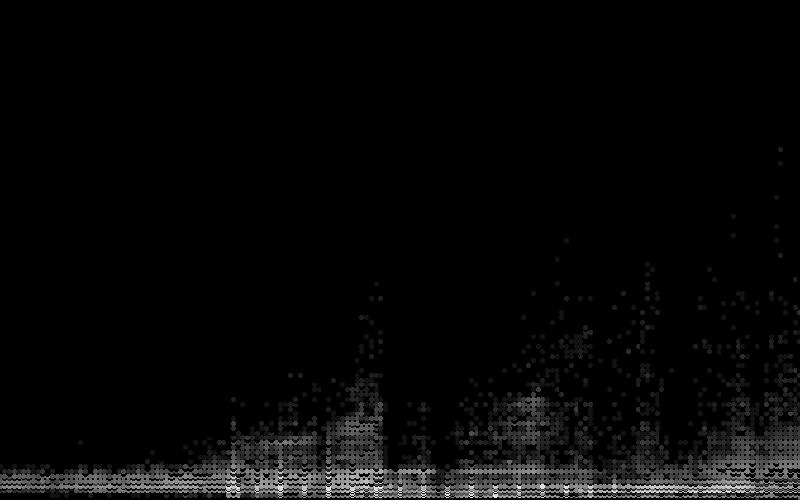

In [60]:
#Defining some helper functions for DataShader
background = "black"
export = partial(export_image, background = background, export_path="export")
cm = partial(colormap_select, reverse=(background!="black"))

cvs = ds.Canvas(800, 500, x_range = (ny['yearbuilt'].min(), ny['yearbuilt'].max()), 
                                y_range = (ny['numfloors'].min(), ny['numfloors'].max()))
agg = cvs.points(ny, 'yearbuilt', 'numfloors')
view = tf.shade(agg, cmap = cm(Greys9), how='log')
export(tf.spread(view, px=2), 'yearvsnumfloors')

That's technically just a scatterplot, but the points are smartly placed and colored to mimic what one gets in a heatmap. Based on the pixel size, it will either display individual points, or will color the points of denser regions.

Datashader really shines when looking at geographic information. Here are the latitudes and longitudes of our dataset plotted out, giving us a map of the city colored by density of structures:

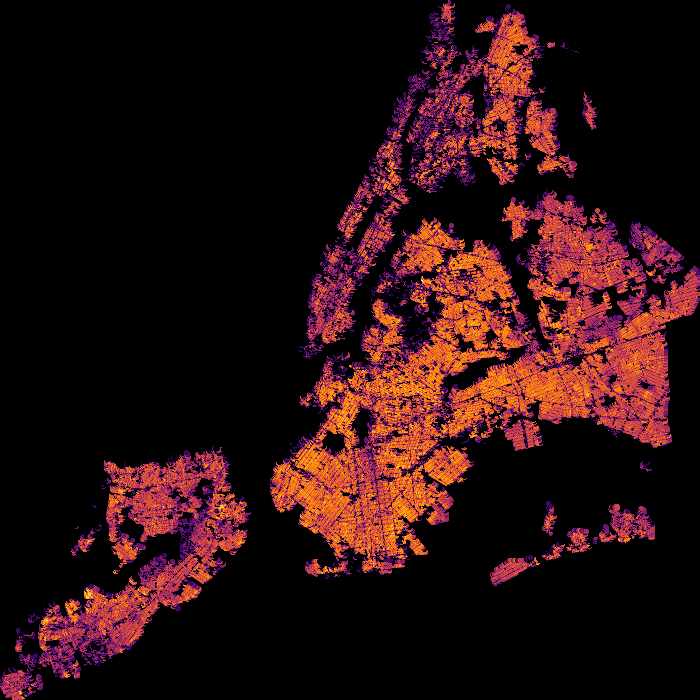

In [61]:
NewYorkCity   = (( 913164.0,  1067279.0), (120966.0, 272275.0))
cvs = ds.Canvas(700, 700, *NewYorkCity)
agg = cvs.points(ny, 'xcoord', 'ycoord')
view = tf.shade(agg, cmap = cm(inferno), how='log')
export(tf.spread(view, px=2), 'firery')

Interestingly, since we're looking at structures, the large buildings of Manhattan show up as less dense on the map. The densest areas measured by number of lots would be single or multi family townhomes.

Unfortunately, Datashader doesn't have the best documentation. Browse through the examples from their [github repo](https://github.com/bokeh/datashader/tree/master/examples). I would focus on the [visualization pipeline](https://anaconda.org/jbednar/pipeline/notebook) and the [US Census](https://anaconda.org/jbednar/census/notebook) Example for the question below. Feel free to use my samples as templates as well when you work on this problem.

### Question

You work for a real estate developer and are researching underbuilt areas of the city. After looking in the [Pluto data dictionary](https://www1.nyc.gov/assets/planning/download/pdf/data-maps/open-data/pluto_datadictionary.pdf?v=17v1_1), you've discovered that all tax assessments consist of two parts: The assessment of the land and assessment of the structure. You reason that there should be a correlation between these two values: more valuable land will have more valuable structures on them (more valuable in this case refers not just to a mansion vs a bungalow, but an apartment tower vs a single family home). Deviations from the norm could represent underbuilt or overbuilt areas of the city. You also recently read a really cool blog post about [bivariate choropleth maps](http://www.joshuastevens.net/cartography/make-a-bivariate-choropleth-map/), and think the technique could be used for this problem.

Datashader is really cool, but it's not that great at labeling your visualization. Don't worry about providing a legend, but provide a quick explanation as to which areas of the city are overbuilt, which areas are underbuilt, and which areas are built in a way that's properly correlated with their land value.

For this question, I looked at three of the data set's variables: `AssessLand`: Assessed Land Value, `AssessTot`: Assessed Total Value, and `ExemptTot`: Exempt Total Value. Because of varying tax laws and the use of the buildings/land, I calculated that the building should be valued with the following formula:

$ buildingValue = AssessTot + ExemptTot - AssessLand$

A new column is added to the `ny` dataframe for `buildingValue`.

In [62]:
# Create a new column called buildingValue using the formula above
ny['buidingValue'] = ny['assesstot'] + ny['exempttot'] - ny['assessland']

# A snippet of the two variables we will look at
ny[['assessland', 'buidingValue']].head(5)

,assessland,buidingValue
1,359100.0,1713600.0
2,300150.0,814500.0
3,33753.0,1151159.0
4,77400.0,1445400.0
5,9600.0,30840.0


According to the Stevens' article, 
> Begin by creating a 3-class sequential color scheme for one of your variables. The color scheme should begin with a very light, neutral color that will represent the lows for the first variable. The color scheme gradually becomes darker and more saturated towards a hue of your choice that will represent the highs.

In following the author's advice, I used one of his prescribed color schemes.


![Color Scheme](https://github.com/logicalschema/Fall-2021/raw/main/DATA608/module2/images/colorscheme.png)


In the article, the author creates a 3x3 matrix legend. I will do likewise.


In [63]:
# Label and ordinal value
landbinLabels = ['A', 'B', 'C'] # A: small, B: medium, C: large
buildbinLabels = ['1', '2', '3'] # 1: small, 2: medium, 3: large

#A        B       C
#64acbe	#627f8c	#574249   3
#b0d5df	#ad9ea5	#985356   2
#e8e8e8	#e4acac	#c85a5a   1

#0        1       2
#64acbe	#627f8c	#574249   2
#b0d5df	#ad9ea5	#985356   1
#e8e8e8	#e4acac	#c85a5a   0

colorsDict = {
   'A1': '#e8e8e8',
   'A2': '#b0d5df',
   'A3': '#64acbe',
   'B1': '#e4acac',
   'B2': '#ad9ea5',
   'B3': '#627f8c',
   'C1': '#c85a5a',
   'C2': '#985356',
   'C3': '#574249',
}




Next, I create the bins to determine the small, medium, and large for the land and building costs. The final classification for the bin is stored in `colorBin`.

In [64]:
ny['landLabel'] = pd.qcut(ny['assessland'], q=3, labels = landbinLabels)
ny['bldgLabel'] = pd.qcut(ny['buidingValue'], q=3, labels = buildbinLabels)
ny['colorBin'] = ny['landLabel'].astype(str) + ny['bldgLabel'].astype(str)
ny['colorBin'] = ny['colorBin'].astype('category')

# Snippet of the binning
ny[['assessland', 'buidingValue', 'colorBin' ]].head()

,assessland,buidingValue,colorBin
1,359100.0,1713600.0,C3
2,300150.0,814500.0,C3
3,33753.0,1151159.0,C3
4,77400.0,1445400.0,C3
5,9600.0,30840.0,A1


# Map of Developed New York City
The following is a map of the developed and undeveloped areas of NYC using the 3x3 matrix from above. 

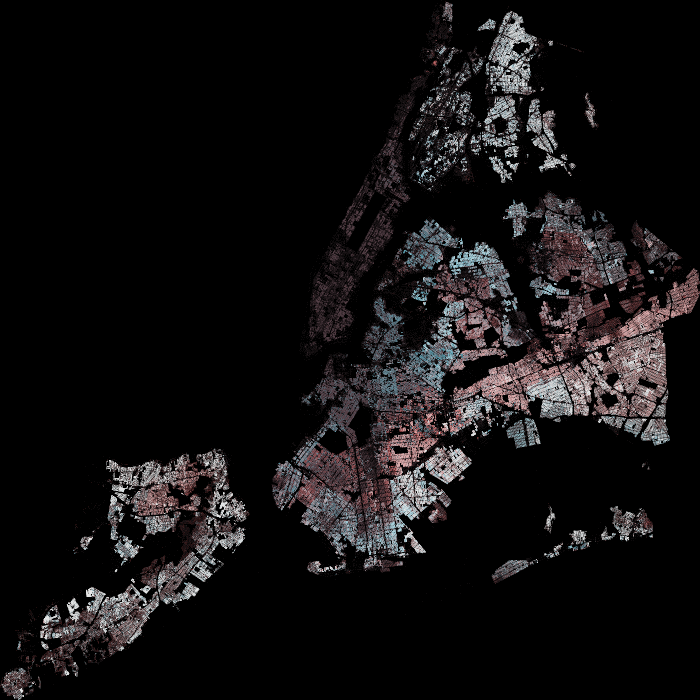

In [65]:
NewYorkCity   = (( 913164.0,  1067279.0), (120966.0, 272275.0))
cvs = ds.Canvas(700, 700, *NewYorkCity)
agg = cvs.points(ny, 'xcoord', 'ycoord', ds.count_cat('colorBin'))
question2aImage = tf.shade(agg, color_key=colorsDict)
export(question2aImage, 'Question 2a Chart')

# Conclusion for Question 2
All of Manhattan, the areas of Brooklyn across from Manhatttan in Astoria, Long Island City, also heading down to Brooklyn College, and the area of Queens in Flushing, College Point, and Murray Hill are heavily developed. The areas that would be worth looking at would be areas along the Belt Parkway of Brooklyn (Canarsie) and around JFK airport as well as Staten Island.